# Setup

First, let's make sure we have no leftovers from previous runs in this environment by deleting the cloned repositories and data.

In [1]:
!rm -rf sunquakes

## Installs

Install gdown library to easily download publicly shared data files from google drive

In [2]:
!pip uninstall gdown -y && pip install gdown
!gdown -V

Found existing installation: gdown 4.4.0
Uninstalling gdown-4.4.0:
  Successfully uninstalled gdown-4.4.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
gdown 4.6.4 at /usr/local/lib/python3.8/dist-packages


Install UMAP Learn library that we will use for visualizing the clusterization of embedded data points

In [3]:
!pip install umap-learn[plot]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 KB 10.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 30.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 81.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.5/76.5 KB 11.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pynndescent: filename=pynndescent-0.5.8-py3-none-any.whl size=55513 sha256=399cd0c2f06aea593c5ed0cd79c05bb18840f6f7544f2d2a22e06e8bbe50cb05
  Stored in directory: /root/.cache/pip/wheels/1c/63/3a/29954bca1a27ba100ed8c27973a78cb71b43dc67aed62e80c3
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=4e6ce6ee979ff48cfee066527592a83af935800d9244062c208c6f7e565d38d0
  Stored in directory: /root/.c

In [4]:
!pip install tensorboard-logger

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Repository Cloning and Data Download

In [5]:
import os

In [6]:
!git clone https://github.com/merceavanessa/sunquakes.git

Cloning into 'sunquakes'...
remote: Enumerating objects: 821, done.
remote: Counting objects: 100% (75/75), done.
remote: Compressing objects: 100% (58/58), done.
remote: Total 821 (delta 20), reused 66 (delta 14), pack-reused 746
Receiving objects: 100% (821/821), 67.37 MiB | 17.50 MiB/s, done.
Resolving deltas: 100% (28/28), done.


In [7]:
os.chdir('./sunquakes/object-detection/')
!gdown '1b9N8wA53w9dFhyB9yP2NEiHaOY9n9JNb'  #download Object Detection checkpoint 

Downloading...
From: https://drive.google.com/uc?id=1b9N8wA53w9dFhyB9yP2NEiHaOY9n9JNb
To: /content/sunquakes/object-detection/object_detector.pt
100% 166M/166M [00:00<00:00, 312MB/s]


In [8]:
!gdown '1adpdHV0_NGjyDqDyIwxlZf-kan2o6ESS' # download unprocessed c24 data
!unzip 'c24_pos_all' -d 'c24_pos_all' # unzip data

Downloading...
From: https://drive.google.com/uc?id=1adpdHV0_NGjyDqDyIwxlZf-kan2o6ESS
To: /content/sunquakes/object-detection/c24_pos_all.zip
100% 11.2M/11.2M [00:00<00:00, 251MB/s]
Archive:  c24_pos_all.zip
   creating: c24_pos_all/neg/
   creating: c24_pos_all/poz/
  inflating: c24_pos_all/poz/img_poz_2013_11_06_13_39_00_97.jpg  
  inflating: c24_pos_all/poz/img_poz_2012_07_06_01_37_00_87.jpg  
  inflating: c24_pos_all/poz/img_poz_2012_03_09_03_22_00_102.jpg  
  inflating: c24_pos_all/poz/img_poz_2012_07_06_01_37_00_93.jpg  
  inflating: c24_pos_all/poz/img_poz_2012_05_09_21_01_00_99.jpg  
  inflating: c24_pos_all/poz/img_poz_2017_09_07_10_11_00_97.jpg  
  inflating: c24_pos_all/poz/img_poz_2017_09_07_14_20_00_112.jpg  
  inflating: c24_pos_all/poz/img_poz_2017_09_07_14_20_00_106.jpg  
  inflating: c24_pos_all/poz/img_poz_2013_11_08_04_20_00_102.jpg  
  inflating: c24_pos_all/poz/img_poz_2017_09_05_01_03_00_91.jpg  
  inflating: c24_pos_all/poz/img_poz_2012_03_06_04_01_00_106.jpg  
 

In [9]:
!gdown '1Qcgn3fP4-_0vO6rZsIgepByR49ZKSbul'
!unzip 'regions_c24'

Downloading...
From: https://drive.google.com/uc?id=1Qcgn3fP4-_0vO6rZsIgepByR49ZKSbul
To: /content/sunquakes/object-detection/regions_c24.zip
100% 29.7k/29.7k [00:00<00:00, 37.1MB/s]
Archive:  regions_c24.zip
   creating: regions_c24/
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2013_01_13_08_35_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2011_03_14_19_30_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2014_02_16_09_20_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2012_07_07_03_10_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2014_10_23_09_44_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2011_09_24_20_29_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2011_09_26_05_06_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2014_10_22_01_16_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2011_07_30_02_04_00.reg  
  inflating: regions_c24/EGRESS_5.0_7.0mHz_PWR_X_T2012_10_23_03_13_00.reg  
  inf

In [10]:
os.chdir('../SupervisedContrastive/')
!gdown '1QR2Ya0ppOcesJehcHPnvu0AyB8gR6k-z' #download data 
!gdown '1nhpEKHQWf5Rbq3492em1L1ja4M2Ns8I0' #download Contrastive Learning checkpoints

Downloading...
From: https://drive.google.com/uc?id=1QR2Ya0ppOcesJehcHPnvu0AyB8gR6k-z
To: /content/sunquakes/SupervisedContrastive/c23_c24_val.zip
100% 319M/319M [00:01<00:00, 301MB/s]
Downloading...
From: https://drive.google.com/uc?id=1nhpEKHQWf5Rbq3492em1L1ja4M2Ns8I0
To: /content/sunquakes/SupervisedContrastive/supcon_ckpt.pth
100% 94.2M/94.2M [00:00<00:00, 261MB/s]


In [11]:
os.mkdir('./out/')
!gdown '111Y0v_0-1CIsj7Blqzu2t8y59kldO8Y5' -O './out/train_embeddings.csv' #download Contrastive Learning train embeddings

Downloading...
From: https://drive.google.com/uc?id=111Y0v_0-1CIsj7Blqzu2t8y59kldO8Y5
To: /content/sunquakes/SupervisedContrastive/out/train_embeddings.csv
100% 108M/108M [00:00<00:00, 251MB/s] 


In [12]:
!unzip 'c23_c24_val.zip' # extract validation set image data 

Archive:  c23_c24_val.zip
   creating: c23_c24_val/
  inflating: c23_c24_val/.DS_Store   
  inflating: __MACOSX/c23_c24_val/._.DS_Store  
   creating: c23_c24_val/neg/
   creating: c23_c24_val/poz/
  inflating: c23_c24_val/neg/img_poz_2012_03_05_19_27_00_237.png  
  inflating: c23_c24_val/neg/img_poz_2013_11_08_04_20_00_116.png  
  inflating: c23_c24_val/neg/img_poz_2012_03_05_19_27_00_223.png  
  inflating: c23_c24_val/neg/img_poz_2015_03_11_16_11_00_5.png  
  inflating: c23_c24_val/neg/img_poz_2015_03_11_16_11_00_232.png  
  inflating: c23_c24_val/neg/img_poz_2012_03_05_19_27_00_67.png  
  inflating: c23_c24_val/neg/img_poz_2012_07_06_13_26_00_219.png  
  inflating: c23_c24_val/neg/img_poz_2012_03_05_19_27_00_73.png  
  inflating: c23_c24_val/neg/img_poz_2015_03_11_16_11_00_226.png  
  inflating: c23_c24_val/neg/img_poz_2012_07_06_13_26_00_231.png  
  inflating: c23_c24_val/neg/img_poz_2012_07_06_13_26_00_225.png  
  inflating: c23_c24_val/neg/img_poz_2012_07_04_09_47_00_234.png  
  

## Imports

### General Imports

In [13]:
# tabular data processing
import pandas as pd
import numpy as np
import datetime as dt

# image data processing
import cv2
from PIL import Image

# visualization
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches

plt.style.use("dark_background")

# dimensionality reduction and clustering
import umap.plot

### Computer Vision imports

In [14]:
# general CV libraries
import torch, torchvision
torch.manual_seed(42)

from torchvision import transforms, models, datasets
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

from torchsummary import summary
from losses import SupConLoss, WeightedSupConLoss

# custom libraries
from util import LowPassTransform, LowPassTransform3D, TwoCropTransform
from dataset_3_ch import MyDataset
from get_embeddings_val import set_loader, initialize_model 

PyTorch Version:  1.13.1+cu116
Torchvision Version:  0.14.1+cu116


### Classification imports

In [15]:
# from sklearn.neighbors import KNeighborsClassifier as knn
# from sklearn.ensemble import BaggingClassifier as knn_bagging
# from sklearn.linear_model import SGDClassifier as sgd
# from sklearn.linear_model import LogisticRegression as logistic_reg
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score
from scipy.spatial import distance

### Smote Imports

In [16]:
import imblearn

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

# Goals

During this workshop we will walk through a full pipeline involving the automatic detection of sunquakes from acoustic emission maps.

We will begin by looking at how Machine Learning works in general, with a brief presentation of Neural Networks. Then, we'll move on to understanding how to predict the time occurence of sunquakes (via Contrastive Learning and Support Vector Classification) and their location (via Object Detection). 

We will see the possible problems that may arrise during the process and familiarize ourselves with tools to help us manage them.

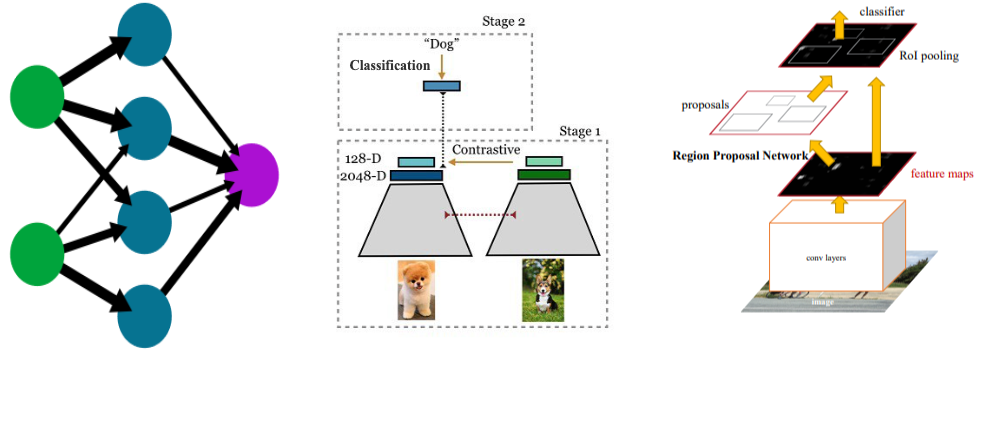

Let's quickly recap the flowchart of the entire process! For this workshop, due to timing and computational constraints, we will skip the data aquisition and preprocessing steps and the actual training of the models.

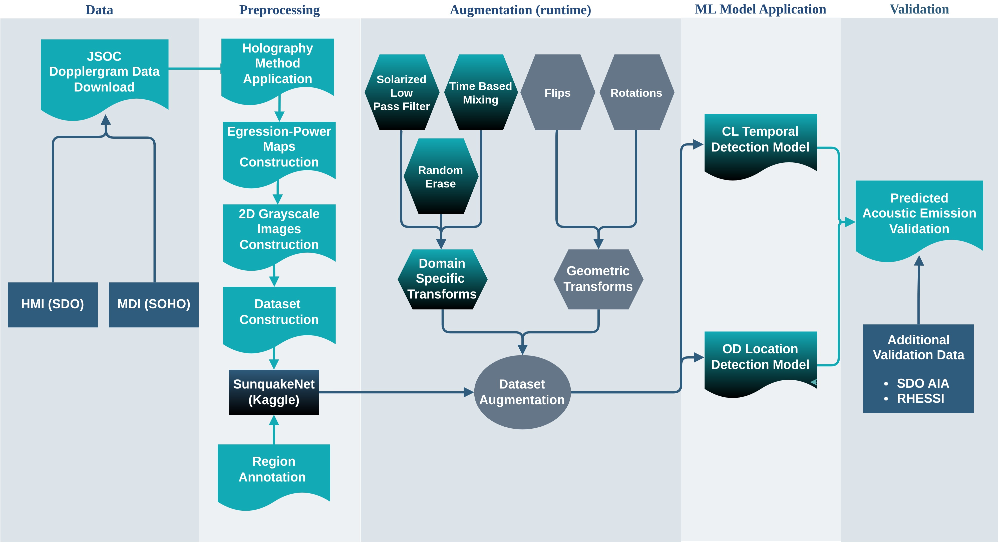

# Machine Learning

Let's begin with a brief introduction into Machine Learning, where we will cover the basics behind neural networks, loss functions and activation functions.

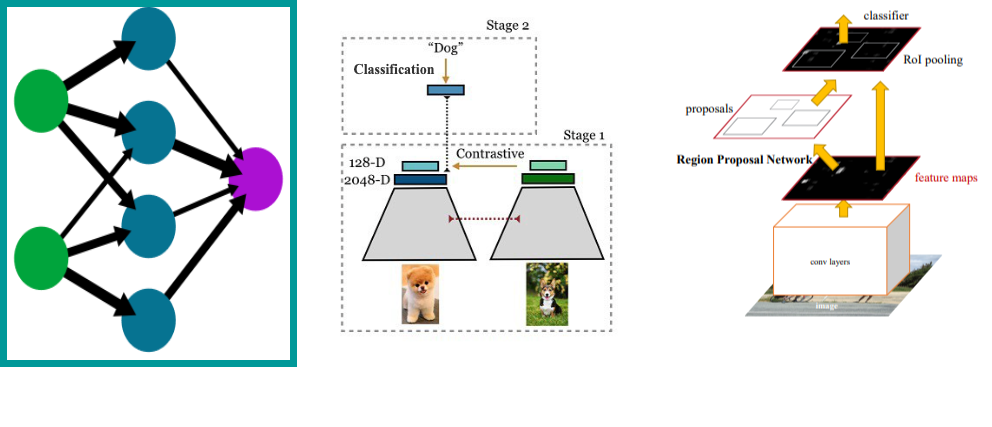

## Machine Learning vs. conventional learning

In Machine Learning, as compared to conventional learning, we learn by example! 

While in conventional learning, the thought process towards solving a problem is knowing what the input for the problem is, and the method or rule by which that input is transformed into an output, in Machine Learning, we have to step outside the box for a bit.

Hence, in Machine Learning we solve a problem by training machines to teach themselves the methods or rules to transform the input. To train machines in this manner, we provide them with inputs and expected outputs, and reward or penalize them based on their responses consistently until they have learned to be as accurate as possible!

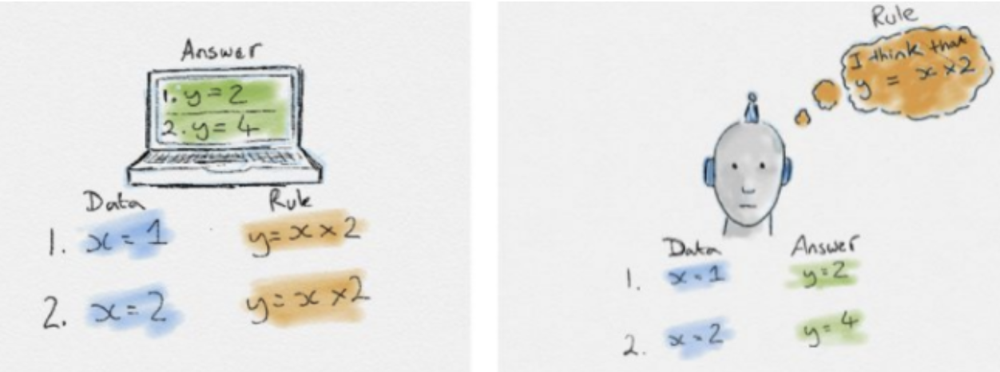

## Neural Networks

Now a big part of what Machine Learning incorporates are Neural Networks. To familiarize ourselves with the concept, let's start with a simple classification example to better understand the process. 

Note: explanation and figures are based on [this link](https://www.youtube.com/watch?v=Pwgpl9mKars)

Let's assume we have a set of animal images that we would like to classify based on species. We have several classes such as Dog, Cat etc.

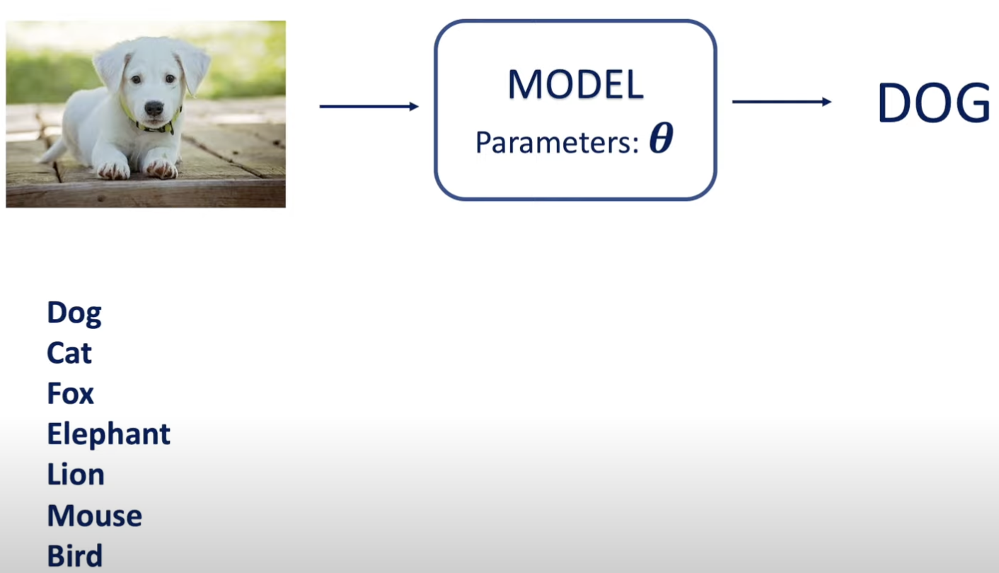

We can then visualize any Neural Network based classification model as a complex mathematical function characterized by a number of parameters that is able to produce a class output.  

For our case, for instance, when provided with an image of a dog, the models' function should be able to produce an output label stating whether the image is a Dog, a Cat or something else. 

BUT... sometimes pictures are not clear, and there is no 100% correct right answer. This is why it's better to allow the model to produce probabilities corresponding to each class instead of a single label output. 

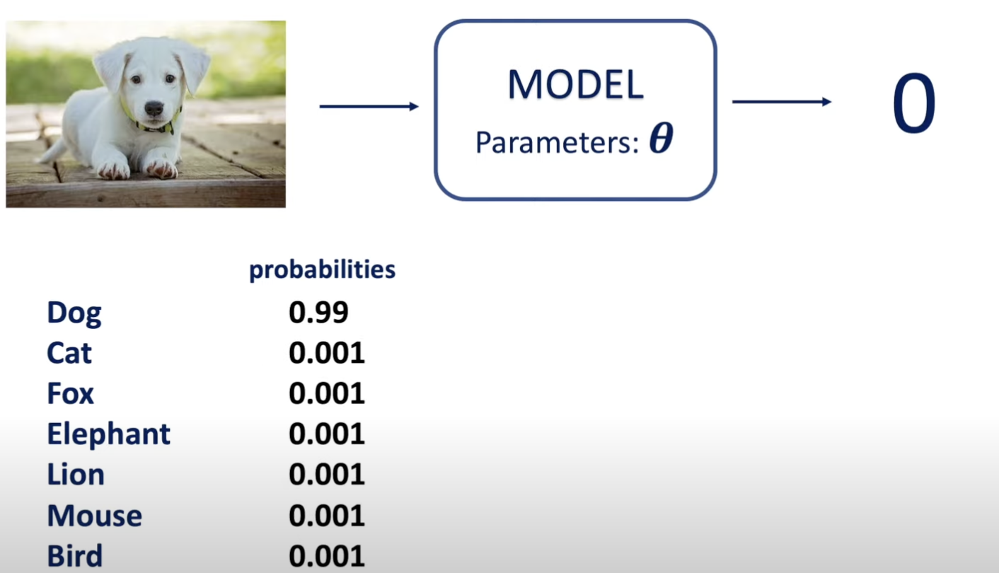

What we would get then, is a set of predicted probabilities for each input image $x_i$ to belong to each class. 

Besides this set of predicted probabilities, to be able to reward and penalize our model we would also need to have access to a set of ground truth or correct probabilities. 

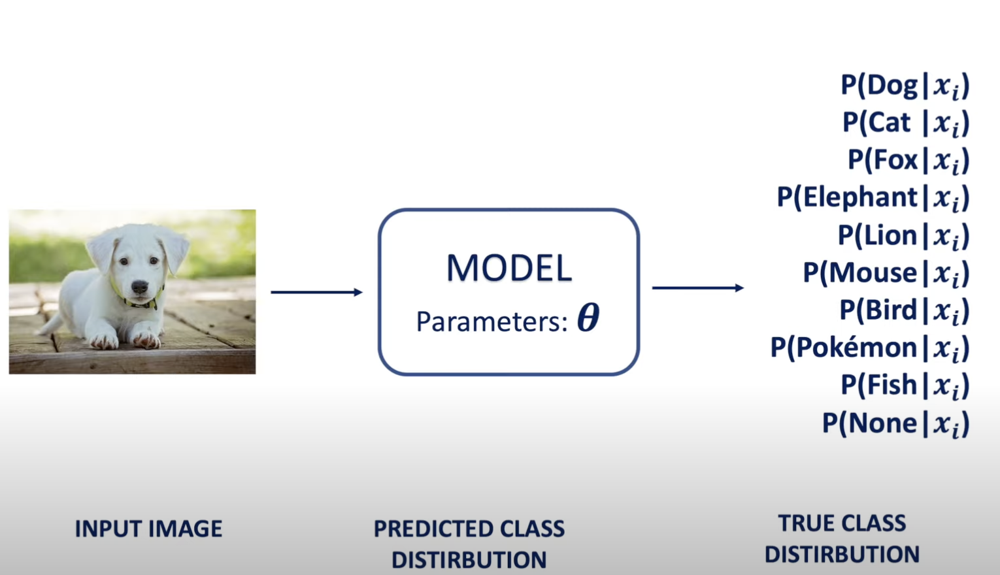

Now typically, the mathematical functions behind a neural network produce non normalized values that definitely don't look like probabilities (as depicted below)!

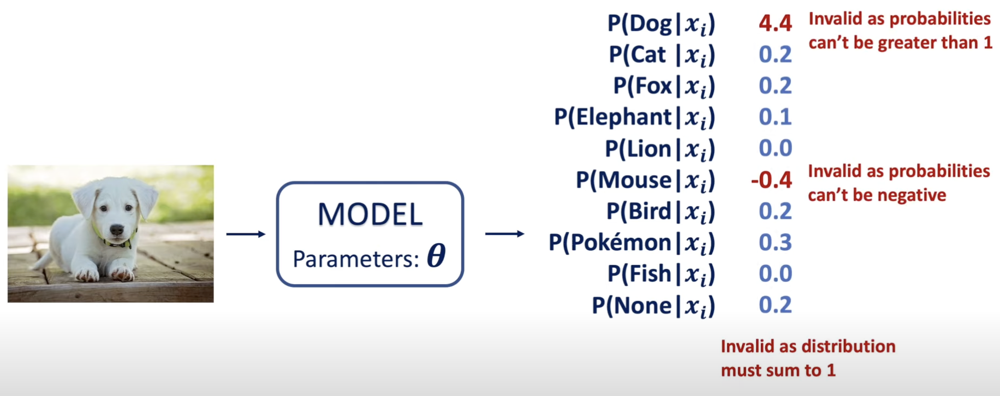

To make sure we end up with valid distributions for our predicted probabilities, we have to enforce this to our neural networks by applying an additional function to its' output called an **activation function**. One of the most commonly used activation functions is the Softmax function Defined below.

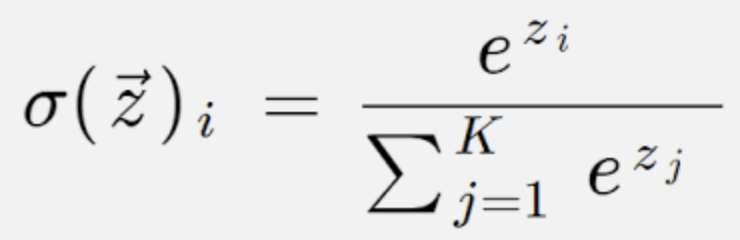

Softmax converts a vector of numbers $z$ into a vector of probabilities, where the probabilities of each value $z_i$ are proportional to the relative scale of each value in the vector.




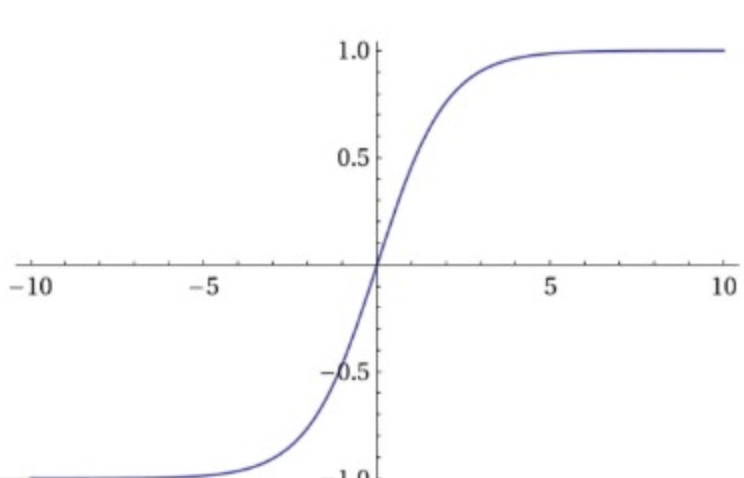

After applying Softmax, the resulting vector for each input $x_i$ should thus have values in the $[0, 1]$ range and have coefficients that sum up to 1. 

Now that our model is able to predict a distribution of probabilities for each input $x_i$, we could deduce the predicted class by picking the highest scoring class.

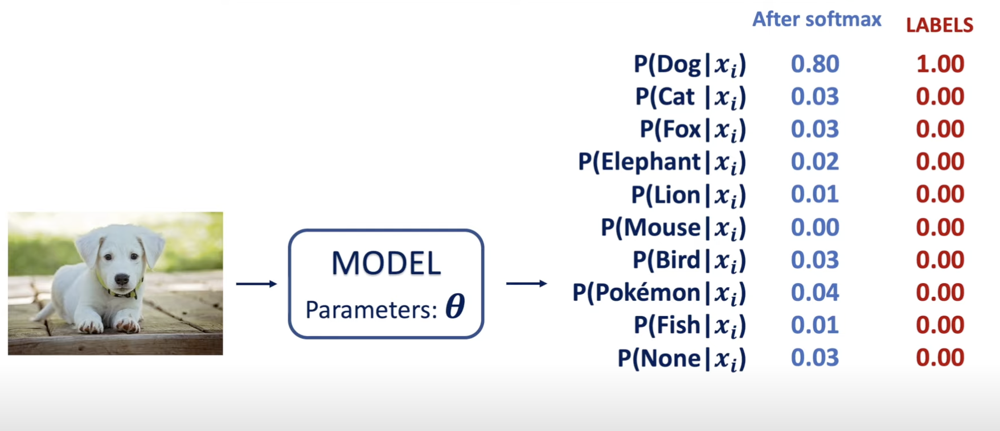

### Loss Functions

By now we should understand how a model produces outputs, but we have not yet understood how the model is able to learn or to produce more accurate probabilities over time. 

This is where loss functions come in handy! They help tell us how "correct" our models' responses are, and, by their minimization they offer a means to adjust the models' function parameters. 

Loss functions are dependent on the neural network predicted output, also called $Y\_pred$, and on the expected result $Y$. 

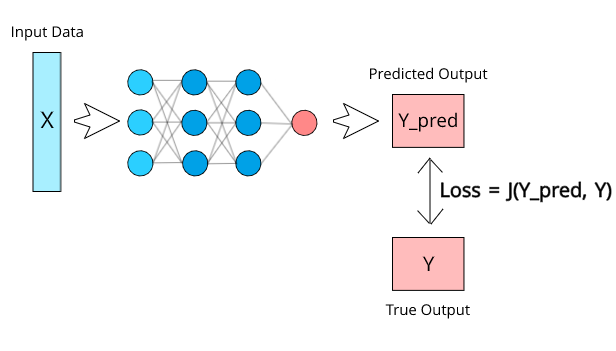

To better understand how any loss function works, it's better to look at a specific example. For this workshop, I chose the most commonly used loss function, precisely the Cross Entropy Loss.

### Cross-Entropy Loss

Cross Entropy Loss measures the correctness of the distribution of probabilities outputed by our model and is defined below as the class-level negative sum of the dot product between the true/correct probability $y_i$ and log of the predicted probability $\hat{ y}_i$

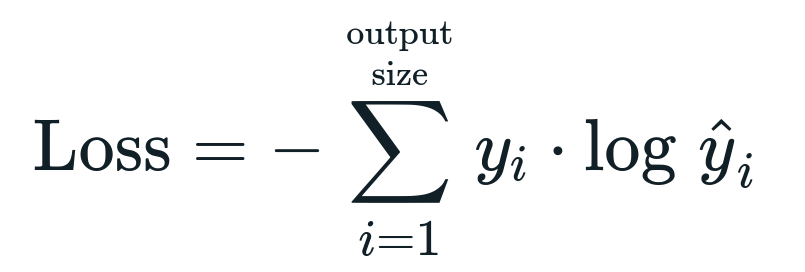

To better understand this formula, let's walk through a concrete example. Let's say we wish that our model can receive an input image and predict one of two classes for that input. For simplicity, let's say the input may be either Dog or Cat. 

The Cross-Entropy loss function would then be computed as follows:

**Loss =**

**\- ((Real Probability of given image to be a Dog * log (Predicted Probability of the given image to be a Dog)**

**\+ (Real Probability of given image to be a Cat * log (Predicted Probability of the given image to be a Cat))**

**FIRST EXAMPLE:**

At a point in time, we **feed our model with a picture of a Cat** and after some computation, the **model predicts that the picture contains a Dog with probability = 1**.


Thus, given the input and model output:

*   Real Probability of given image to be a Dog is 0 as we fed our model with a Cat image
*   Real Probability of given image to be a Cat is 1 as we fed our model with a Cat image
*   Predicted Probability of given image to be a Dog is 1 as we our model predicted Dog with probability 1
*   Predicted Probability of given image to be a Cat is 0 as we our model predicted Dog with probability 1

The output of our Cross Entropy Loss function would then be:

Loss = - ((0 * log (1)) + (1 * log (0)))

Loss = - (0 + (- infinity)) = infinity

As an output, we end up with a very high loss, indicating that the model is not performing well at all for this example!




**SECOND EXAMPLE:**


Let's repeat the process for a scenario where we **feed another picture of a Cat **to our model but this time **the model correctly predicts a Cat** with probability = 1.

Loss = - ((0 * log (0)) + (1 * log(1))) = - (0 + 0) = 0 

This time with a minimum loss, indicating that the model has done well!


### Backpropagation

Ok, we have seen how a neural network is capable of producing probabilistic outputs and we now have a basic understanding of how to measure the error of those probabilities through loss functions.

But we still have not learned how we can improve the outputs of our model...

We mentioned earlier that neural networks can essentially be visualized as complex mathematical functions with a set of parameters. Now as for any mathematical function, these parameters (also called weights) can be adjusted. 

We wish to adjust them taking into account the error that was measured by the loss function. We can thus take the error and feed it back through the neural network through a process called **backpropagation**.

To determine in what direction we should adjust the model parameters to get a lower loss/error in our next tries, gradient descent optimization function can be used as a backpropagation algorithm. 

Note: For a great explanation on gradient descent algorithm, please watch [this YT video](https://www.youtube.com/watch?v=sDv4f4s2SB8) 

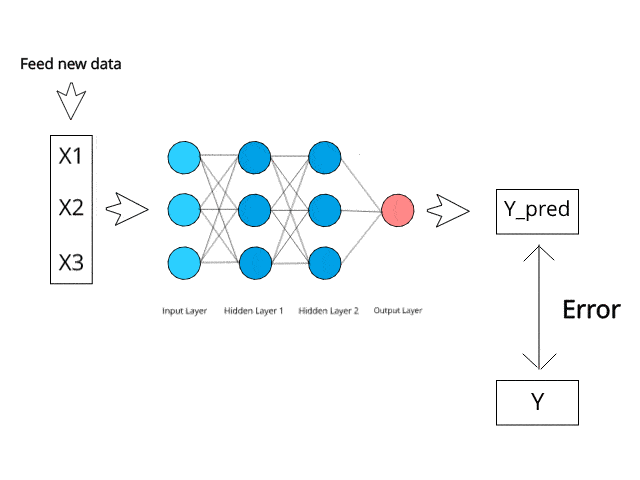

### Feature Extraction

Now depending on the machine learning problem that needs solving, we sometimes may want for our models to predict a floating point value (e.g. when predicting the cost of a product) and some other times, a class (e.g. when predicting the species of an animal).

However.. there are situations when neural networks are used as an intermediary step in a larger process, with the purpose of extracting information from data instead of predicting numbers or probabilities. This approach is called **feature extraction**. :)

For our problem of detecting sunquakes, before performing classification (so before attempting to output probabilities), we wanted to earn information from our data. We applied feature extraction in the form of Contrastive Learning, by which we converted our input images into 1D vectors.

# Predicting Time Occurence: Contrastive Learning 

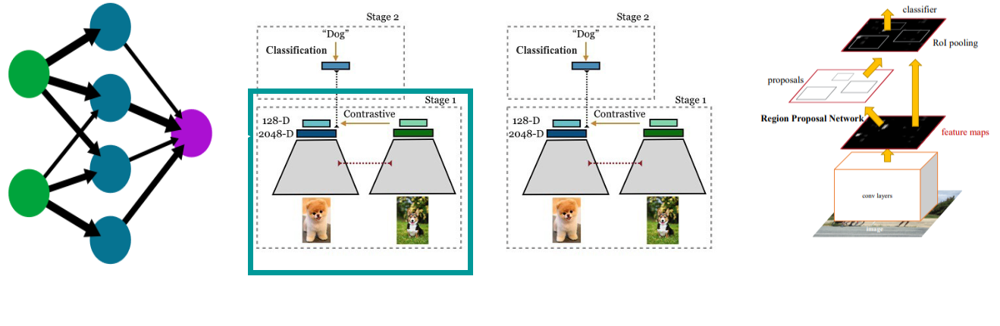

In this section we will learn how to extract sunquake-presence information from image data into feature vectors.

## Algorithm

Goal: learn the similarity between different input data based on class labels and augmentations!

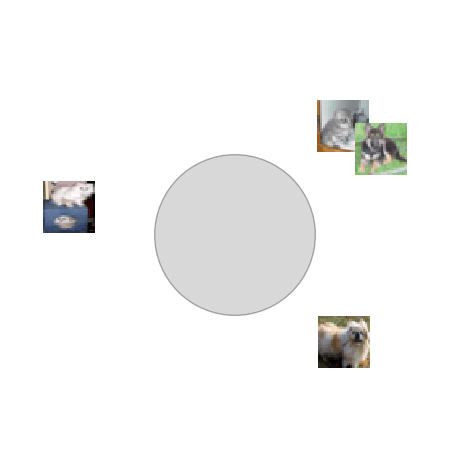

How do we achieve this?...

Loss function does all the work for us! Let's look at the [Supervised Contrastive Loss](https://arxiv.org/pdf/2004.11362.pdf). This is very similar to the Softmax function we discussed about above! with the exception that we disregard the reference input in the denominator. With SupCon, we attempt to minimize the softmaxed likelihood that any two samples belonging to the sameclass have similar distributions.

To put it simply, we first compute the similarity sim between a reference image and other samples of the same class, and then we apply softmax to all the similarities to achieve a correct distribution. Then, we define the loss li by the sum of the log likelihoods of each of these probabilities divided by the total number of reference images.

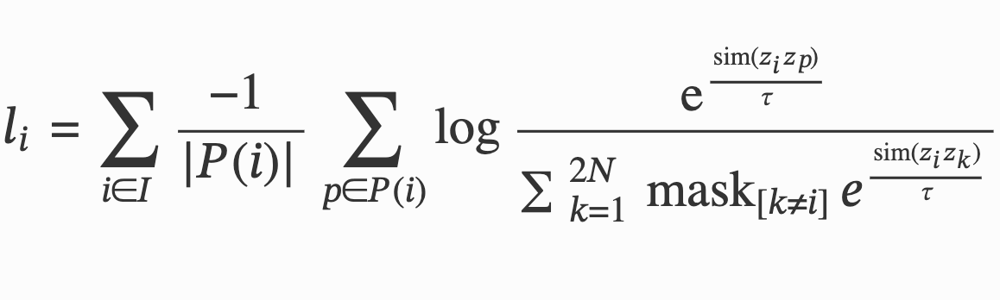

In the equation above,   𝑃
 represents the set of indices of the positives, which are all of the samples that share the same class as the anchor and their augmentations.
 
 p thus represents a positive sample (same class or augmented version as image i), mask
 is an indicator function evaluating to 1 if 𝑘≠𝑖
, 𝑧
 represents the embedding obtained from passing the input through the model, sim
 represents cosine similarity. 𝜏
 is a parameter, called the temperature in ML terminology, used to regularize the contribution of representations. This does not correspond to a physical temperature.

At low temperatures, smaller distances are favored, which leads to better capturing of minor differences, but making training more difficult since numerical instability increases. In the experiments performed on our data, a temperature factor lower than 𝜏=0.07
 is not usable due to this instability, and generally values of 𝜏∈[0.07,0.1]
 work best.



## Architecture

Instead of defining new architectures for our models and training them from scratch, we used pretrained models (trained on a wide corpus of images called ImageData). 

The main used architecture for the pretrained model we used is Resnet-18. Typically, Deep Learning architectures have a **backbone** consisting of a chain of neural networks and a **classification head**, but for our scenario, we discarded the classification head because our desired output was a feature/embedding vector instead of a probability distribution.

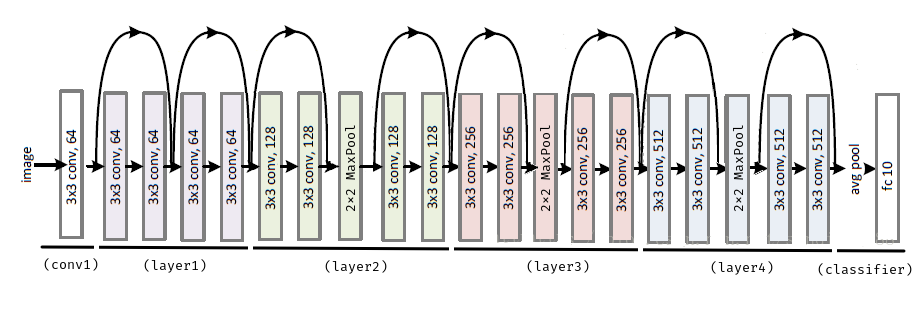

## Model Training

We repeat the following steps:

1. Set up a neural network that is capable of receiving image inputs and output vectors (capable of performing feature extraction)
2. Train the network as follows:

*   Take a batch of input images and pass it through the neural network 
*   Take the resulting embedding vectors for the batch
*   Apply the SupCon loss function to these
*   Backpropagate the loss function to update the networks' parameters 
*   Repeat until satisfied with loss function value :D








## What could go wrong? ...

Easter eggs may include:


*   Seeing that loss function doesn't decrease at all (fluctuates)
*   Having the loss function be stuck in a local minima

=> no learning 

## What can we do?

So what can we do when training doesn't work?... Well many typical things like:



*   Hyperparameter Tuning
*   Loss function weighting
*   Changing the optimizer
*   Increasing/Decreasing the complexity (size and architecture) of the neural network 


BUT **with image data, Augmentations are the holy grail**!

## Augmentations

Augmentations are transformations that are typically randomly applied to images during training to:

*   Provide a wider variety of examples to the models
*   Support the model's ability to generalize
*   Enhance important features in the images

Common techniques include:



*   Geometric transforms (rotations, flips)
*   Crop transforms (crops, erasing) 
*   Structure altering transforms (color alterations, blurs, frequency enhancement)
* Mixing transforms (combining multiple images)

[torchvision.transforms](https://pytorch.org/vision/stable/transforms.html) is a great place to start!

Let's have a look at the transforms that helped our models converge!

### Mixing Transforms

Because our image data consists of sunquakes, it's crucial that the time constraint required for the detection of sunquakes (meaning that the sunquake signature is maintained for multiple frames) is somehow inferred to our models.

For this, we create a custom transform through which we combine each 3 consecutive images corresponding to each event into a single image with three grayscale channels.

The images downloaded for this workshop are already processed with this transform, as we apply it to all data before training, instead of randomly at train time as with other transforms, as exemplified below.


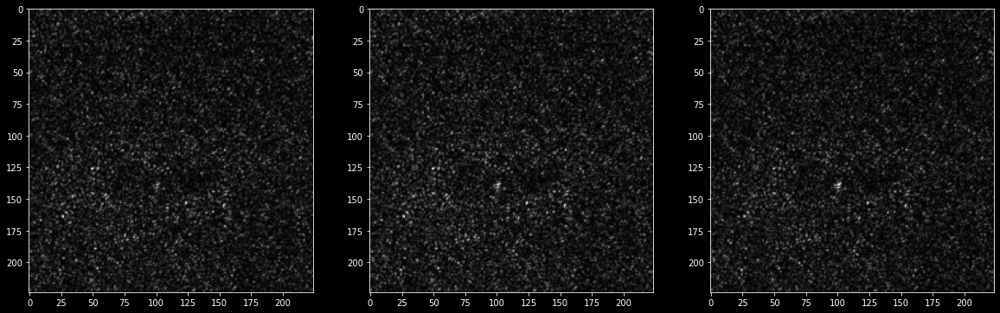

In [17]:
from google.colab.patches import cv2_imshow

fig = plt.figure(figsize=(20, 14))
img = cv2.imread('./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png')
ax = fig.add_subplot(2, 3, 1)
ax.imshow(img[:,:,0], cmap='gray')

ax = fig.add_subplot(2, 3, 2)
ax.imshow(img[:,:,1], cmap='gray')

ax = fig.add_subplot(2, 3, 3)
ax.imshow(img[:,:,2], cmap='gray')


Here's how the model processes each image constructed in this way!

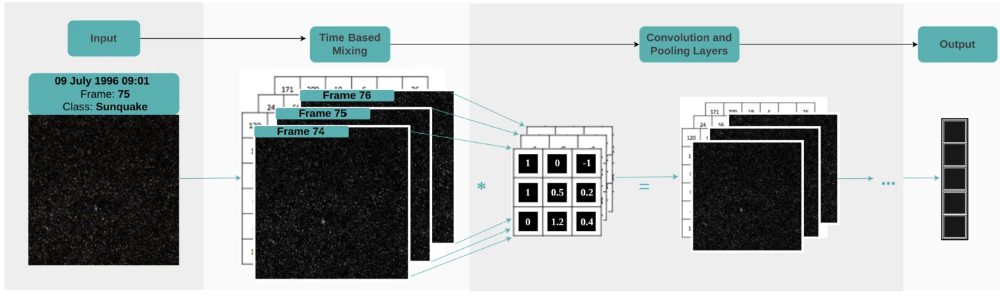

### Geometric Transforms

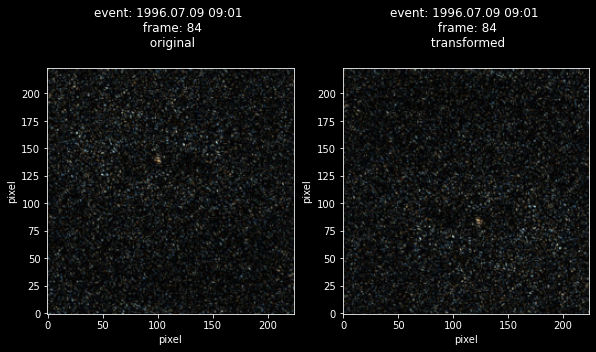

In [18]:
geometric_transforms = transforms.RandomChoice([
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.RandomRotation(degrees=[90,90]),
        transforms.RandomRotation(degrees=[180, 180]),
        transforms.RandomRotation(degrees=[270, 270])
    ])

fig = plt.figure(figsize=(15, 14))
img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 1)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n original\n')
ax.imshow(img, origin='lower', cmap='gray')

img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 2)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n transformed\n')
ax.imshow(geometric_transforms(img), origin='lower')

### Crop Transforms (Random Erase)

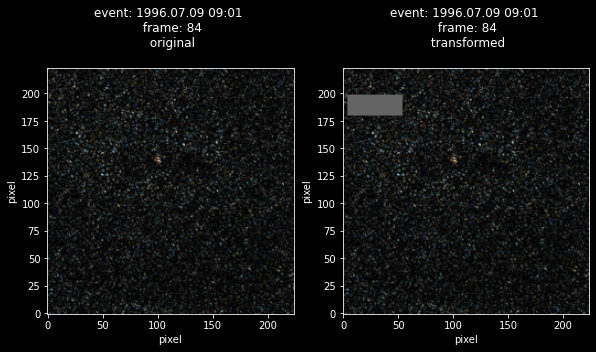

In [19]:
tensor_transform = transforms.Lambda(lambda x: torch.tensor(x))

random_erase_transform = transforms.RandomApply([
                transforms.RandomErasing(p=0.05, scale=(0.04, 0.05), ratio=(0.2,0.6), value=100),
                transforms.RandomErasing(p=0.05, scale=(0.04, 0.05), ratio=(0.3,0.6), value=100),
                transforms.RandomErasing(p=0.1, scale=(0.03, 0.04), ratio=(0.4,0.6), value=100),
                transforms.RandomErasing(p=0.1, scale=(0.03, 0.04), ratio=(0.5,0.5), value=100),
                transforms.RandomErasing(p=0.2, scale=(0.02, 0.03), ratio=(0.5,0.5), value=100),
                transforms.RandomErasing(p=0.2, scale=(0.02, 0.03), ratio=(0.4,0.6), value=100),
                transforms.RandomErasing(p=0.5, scale=(0.01, 0.02), ratio=(0.3,0.6), value=100),
                transforms.RandomErasing(p=0.5, scale=(0.01, 0.02), ratio=(0.2,0.6), value=100),
    ],p=1)

random_erase_composed = transforms.Compose([
    transforms.Lambda(lambda x: np.transpose(np.asarray(x), (2,0,1))),
    tensor_transform,
    random_erase_transform,
    transforms.ToPILImage()
])

fig = plt.figure(figsize=(15, 14))
img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 1)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n original\n')
ax.imshow(img, origin='lower', cmap='gray')

img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 2)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n transformed\n')
ax.imshow(random_erase_composed(img), origin='lower')

### Structure transforms (Solarized Low Pass)

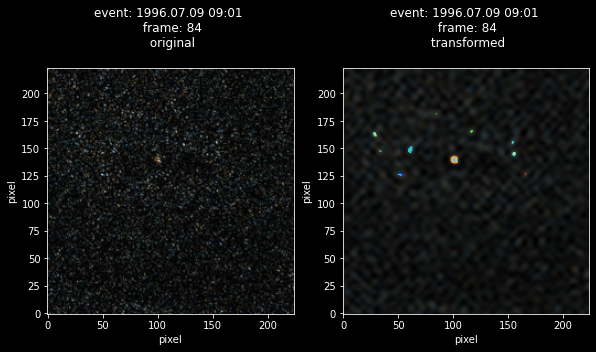

In [20]:
low_pass_transform = transforms.Compose([LowPassTransform3D(threshold=50, probability=1),
                        transforms.RandomSolarize(threshold=50, p=1)])

low_pass_composed = transforms.Compose([
    transforms.Lambda(lambda x: np.transpose(np.asarray(x), (2,0,1))),
    low_pass_transform,
    transforms.ToPILImage()
])

fig = plt.figure(figsize=(15, 14))
img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 1)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n original\n')
ax.imshow(img, origin='lower', cmap='gray')

img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 2)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n transformed\n')
ax.imshow(low_pass_composed(img), origin='lower')

### Final train transforms

The final transforms that we use for training our models are a combination of all the above, with the Time Based Mixing being applied beforehand to all samples, while the remainder are applied randomly at runtime.

In [21]:
train_transform =  transforms.Compose([
                    transforms.Lambda(lambda x: np.transpose(np.asarray(x), (2,0,1))),
                    transforms.RandomChoice([low_pass_transform, tensor_transform],p=[0.1,0.0]),
                    geometric_transforms,
                    random_erase_transform,
                    transforms.ToPILImage()
            ])

Text(0.08, 0.295, 'Solarized Low Pass Filter')

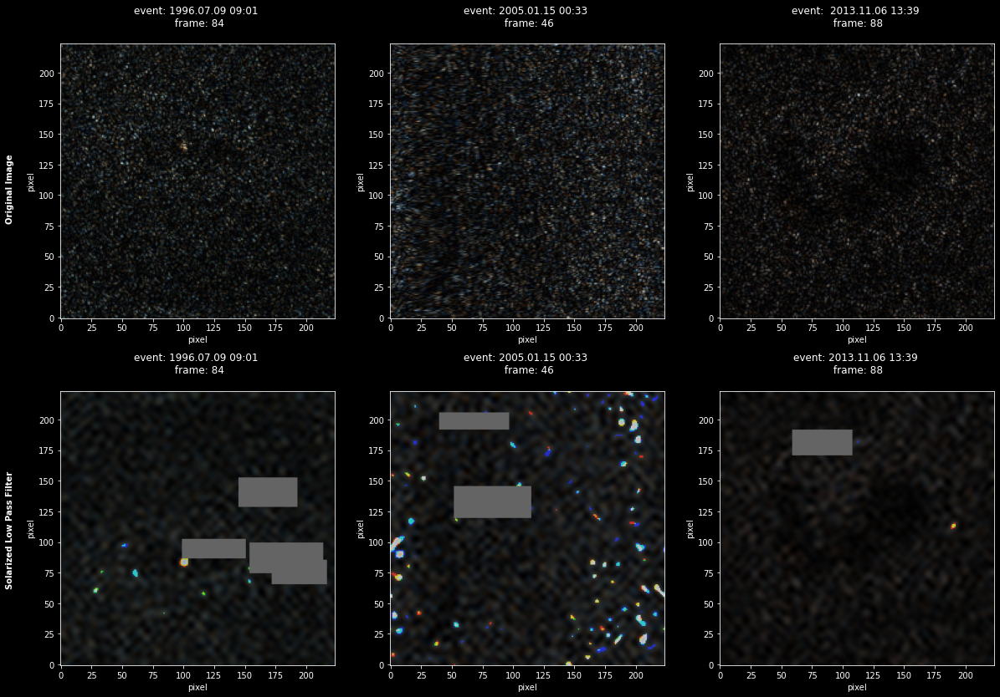

In [22]:
fig = plt.figure(figsize=(20, 14))
img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 1)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n')
ax.imshow(img, origin='lower', cmap='gray')

img = Image.open(f"./c23_c24_val/poz/img_poz_2002_07_23_00_27_00_41.png")
ax = fig.add_subplot(2, 3, 2)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 2005.01.15 00:33 \n frame: 46\n')
ax.imshow(img, origin='lower')

img = Image.open(f"./c23_c24_val/poz/img_poz_2013_11_08_04_20_00_101.png")
ax = fig.add_subplot(2, 3, 3)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event:  2013.11.06 13:39 \n frame: 88\n')
ax.imshow(img, origin='lower')

img = Image.open(f"./c23_c24_val/poz/img_poz_1996_07_09_09_01_00_84.png")
ax = fig.add_subplot(2, 3, 4)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 1996.07.09 09:01 \n frame: 84\n')
ax.imshow(train_transform(img), origin='lower')

img = Image.open(f"./c23_c24_val/poz/img_poz_2002_07_23_00_27_00_41.png")
ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 2005.01.15 00:33 \n frame: 46\n')
ax.imshow(train_transform(img), origin='lower')

img = Image.open(f"./c23_c24_val/poz/img_poz_2013_11_08_04_20_00_101.png")
ax = fig.add_subplot(2, 3, 6)
ax.set_xlabel(f'pixel')
ax.set_ylabel(f'pixel')
ax.set_title(f'event: 2013.11.06 13:39 \n frame: 88\n')
ax.imshow(train_transform(img), origin='lower')

fig.text(0.08, 0.7, 'Original Image', va='center', rotation='vertical', weight='bold')
fig.text(0.08, 0.295, 'Solarized Low Pass Filter', va='center', rotation='vertical', weight='bold')

## Model Inference

Below, we configure program arguments to match what we have used during training.

In [23]:
opt = lambda: None
opt.encoding_size = 512
opt.model = 'resnet18'
opt.data_folder = './c23_c24_val/'
opt.batch_size = 32
opt.num_workers = 4
opt.latent_dim = 128
opt.syncBN = False
opt.ckpt = './supcon_ckpt.pth'
opt.temp = 0.08

target_file = f"./out/val_embeddings.csv"
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(opt.data_folder, device)

./c23_c24_val/ cuda:0


We initialize the test data loader and model that will be loaded from a checkpoint.

With checkpoints, we can save and load model states from any point in the training process! So a nice thing about them is that we can check the loss function graph and pick the best model based on the timing of the loss function minima!

In [24]:
test_loader = set_loader(opt)
model  = initialize_model(opt, device, use_pretrained=True)

Loading custom dataset...
Total events: 11
Positives: 186
Negatives: 2622


/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also u

  0%|          | 0.00/44.7M [00:00<?, ?B/s]

Sequential(
  (0): Linear(in_features=512, out_features=512, bias=True)
  (1): ReLU(inplace=True)
  (2): Linear(in_features=512, out_features=128, bias=True)
)


Let's apply our model to the test data that we have downloaded earlier. 

In [25]:
model.eval() # set the model to evaluation mode 
print("Perform inference...")
df = pd.DataFrame() # create a dataframe to save CL embeddings in
for idx, item in enumerate(test_loader): # for each batch of images
    (images, labels, names) = item
        
    if torch.cuda.is_available(): # cast the pixel values to float
        image = images[0].float().to(device)
    else:
        image = images[0].float()
    
    bsz = labels.shape[0] # find the batch size
    with torch.set_grad_enabled(False): # disable gradients (i.e. disable learning)
        features = model.encoder(image) # apply the CL algorithm to obtain embedding vectors

    new_df = pd.DataFrame(data=features.view(bsz, -1).cpu().detach().numpy()) # save embedding vectors
    new_df['label'] = labels.cpu().detach().numpy() # save labels
    new_df['name'] = names # save names
    
    df = pd.concat([df,new_df]) # append newly computed embedding vectors to df

df.to_csv(target_file, index=False) # save embeddings

Perform inference...


Let's take a look at how the resulting feature vectors look like!

In [26]:
df

,0,1,2,3,4,5,6,7,8,9,...,504,505,506,507,508,509,510,511,label,name
0,-0.239879,-0.158320,-0.069493,-0.105279,0.057808,0.152449,-0.072609,-0.036487,0.179223,0.014754,...,-0.085626,0.124856,-0.019882,0.077209,0.000721,-0.148335,0.029511,-0.016896,0,./c23_c24_val/neg/img_poz_2013_11_08_04_20_00_...
1,-0.264728,-0.247405,-0.296466,0.006919,-0.141514,0.133231,-0.038231,-0.089814,0.208029,0.074012,...,-0.160172,0.270972,-0.018072,0.094435,0.094709,-0.341253,0.150808,0.069505,0,./c23_c24_val/neg/img_poz_2002_07_23_00_27_00_...
2,-0.241008,-0.192615,-0.253004,-0.016809,-0.093664,0.144958,-0.017562,-0.085212,0.171562,0.068417,...,-0.138998,0.227586,-0.006698,0.115855,0.067441,-0.280701,0.088116,0.050261,0,./c23_c24_val/neg/img_poz_2001_04_06_19_13_00_...
3,-0.167246,-0.074861,0.038022,-0.136021,0.112295,0.111169,-0.057288,0.004679,0.116154,-0.022729,...,-0.034245,0.038429,-0.011799,0.038854,-0.040232,-0.033277,-0.030075,-0.043321,1,./c23_c24_val/poz/img_poz_2012_07_06_13_26_00_...
4,-0.169256,-0.114766,-0.080194,-0.056867,0.004687,0.102308,-0.036223,-0.019860,0.119500,0.014214,...,-0.067584,0.112912,-0.008336,0.053907,0.000555,-0.131417,0.029799,0.004068,0,./c23_c24_val/neg/img_poz_2001_04_06_19_13_00_...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19,-0.211875,-0.147265,-0.229712,-0.064300,-0.066740,0.137662,-0.002737,-0.079110,0.155991,0.042620,...,-0.110784,0.207474,0.004740,0.090318,0.069349,-0.225803,0.057848,0.027675,0,./c23_c24_val/neg/img_poz_2001_04_06_19_13_00_...
20,-0.218853,-0.141789,-0.058504,-0.134978,0.058241,0.144504,-0.073980,-0.024850,0.171511,-0.000003,...,-0.070800,0.116843,-0.017511,0.050737,0.006984,-0.126037,0.026692,-0.026945,0,./c23_c24_val/neg/img_poz_2013_11_08_04_20_00_...
21,-0.162702,-0.102858,-0.127171,-0.061944,-0.024414,0.109450,-0.010293,-0.041696,0.118496,0.021449,...,-0.073768,0.136993,0.002829,0.066360,0.023265,-0.140805,0.025006,0.004087,0,./c23_c24_val/neg/img_poz_2001_04_06_19_13_00_...
22,-0.330696,-0.240649,-0.322062,-0.088001,-0.075123,0.219020,-0.034209,-0.134060,0.252613,0.084221,...,-0.168671,0.298626,0.010674,0.149894,0.098359,-0.348323,0.114029,0.041812,0,./c23_c24_val/neg/img_poz_2013_11_08_04_20_00_...


Now that we have these features computed, all we can hope for is that they encapsulate the sunquake information! Let's attempt to apply binary classification to these vectors, and later on, see how the vectors are clustered when reduced to a 2D space.

# Predicting Time Occurence: Classification 

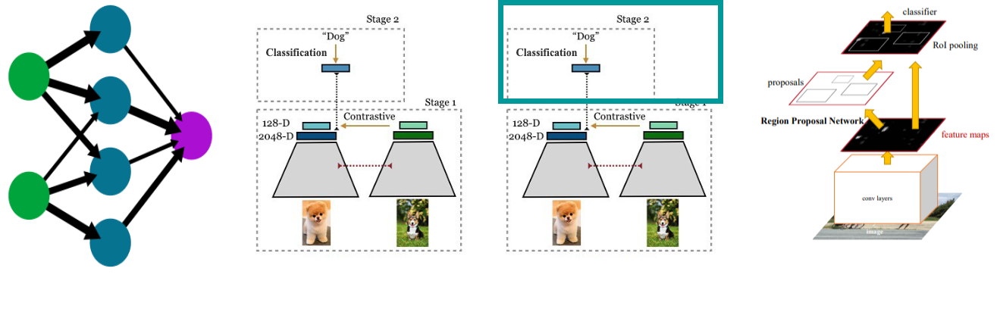

In this section we will learn how to predict the time occurence of a suquake from CL obtained vectors.

In [27]:
has_tr_train = True # True as during training, the images were upsampled with transformed versions
has_tr_test = False # False as we are only performing validation on a non-upsampled set

encoding_size = 512 # embedding vector size
run_on_raw = True # only consider original image data (ignore the upsampled versions)

In [28]:
df_train = pd.read_csv('./out/train_embeddings.csv') # read precomputed train embeddings
df_test = pd.read_csv('./out/val_embeddings.csv') # read validation embeddings computed above

# df_test['name']= df_test['name'].str.replace('pos-concat-val','pos-concat')
# df_train['name']= df_train['name'].str.replace('pos-upsampled-concat','pos-concat')
# df_test['name']= df_test['name'].str.replace('pos-upsampled-concat','pos-concat')
# df_test['name']= df_test['name'].str.replace('dataset/C','dataset/all/C')
df_train = df_train[~df_train['name'].isin(df_test['name'])]

In [29]:
len(df_train), len(df_test) # check number of train and test examples

(18019, 2808)

Constants

In [30]:
cols_to_extract_no_tr  = ['u1','u2', 'u3', 'part_of_quake','Year','month','day','Hour','Minute','Seconds','frame']
cols_to_extract_has_tr  = cols_to_extract_no_tr + ['transform']
emb_cols = [f'{x}' for x in range(0,encoding_size)]

Extract dataframe columns from each images' name

In [31]:
def update_cols(df, has_tr):
    if (has_tr):
        df[cols_to_extract_has_tr] = df['name'].str.split('_', expand=True)
        df.loc[df['transform'].isna(),'transform'] = '20'
        df['transform'] = df['transform'].str.extract('(\d+)', expand=False)
        df['transform']=df['transform'].astype(int)
    else:
        df[cols_to_extract_no_tr] = df['name'].str.split('_', expand=True)
    
    df['frame'] = df['frame'].str.extract('(\d+)', expand=False)
    df['frame']=df['frame'].astype(int)
    return df

def set_preds(df_train, df_test, preds_train, preds_test, clstype):
    df_train[clstype+'_preds'] = preds_train
    df_test[clstype+'_preds'] = preds_test

In [32]:
df_train = update_cols(df_train, has_tr=has_tr_train)
df_test = update_cols(df_test, has_tr=has_tr_test)

Convert date information into a singular datetime-format column

In [33]:
df_train['date'] = pd.to_datetime(df_train[['Year', 'month', 'day', 'Hour','Minute','Seconds']])
df_train['date'].unique() 

df_test['date'] = pd.to_datetime(df_test[['Year', 'month', 'day', 'Hour','Minute','Seconds']])
df_test['date'].unique()


array(['2013-11-08T04:20:00.000000000', '2002-07-23T00:27:00.000000000',
       '2001-04-06T19:13:00.000000000', '2012-07-06T13:26:00.000000000',
       '2001-09-24T09:35:00.000000000', '2015-09-28T14:53:00.000000000',
       '2012-07-04T09:47:00.000000000', '2012-03-06T07:52:00.000000000',
       '1996-07-09T09:01:00.000000000', '2015-03-11T16:11:00.000000000',
       '2012-03-05T19:27:00.000000000'], dtype='datetime64[ns]')

In [34]:
if run_on_raw:
    if (has_tr_train):
        df_train = df_train[df_train['transform'] == 20]
    if (has_tr_test):
        df_test = df_test[df_test['transform'] == 20]

## SMOTE

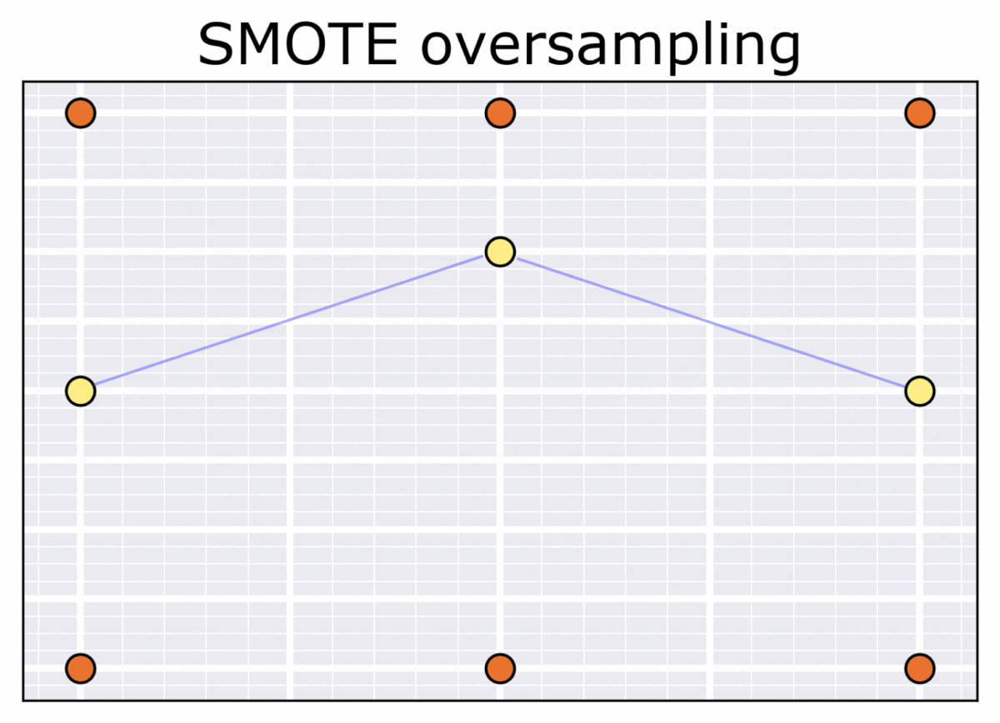

Before applying over/undersampling, the data should be scaled. 

In [35]:
scaler = StandardScaler()
scaled_train = scaler.fit_transform(df_train[emb_cols])
scaled_test = scaler.transform(df_test[emb_cols])

We synthetically up-sample positives with a sampling strategy of 0.2, and down-sample negatives with a sampling strategy of 0.75. By this, first the positive samples are increased so that they measure 20% of the total count of the negative samples, and the negative samples are reduced until the positive count is equal to 75% of the negative count,

In [36]:
over = SMOTE(sampling_strategy=0.2) 
under = RandomUnderSampler(sampling_strategy=0.75)

steps = [('o', over), ('u', under)]
pipeline = Pipeline(steps=steps)

X, y = pipeline.fit_resample(scaled_train, df_train['label'])
print (f'Negative count after SMOTE: {len([x for i,x in enumerate(y) if x == 0])}')
print (f'Positive count after SMOTE: {len([x for i,x in enumerate(y) if x == 1])}')

Negative count after SMOTE: 3452
Positive count after SMOTE: 2589


## Support Vector Classification

Train and Test for binary classification using Support Vector Machine Classifier.

[sklearn](https://scikit-learn.org/) is a great library to use for classification tasks, with numerous classifiers included!


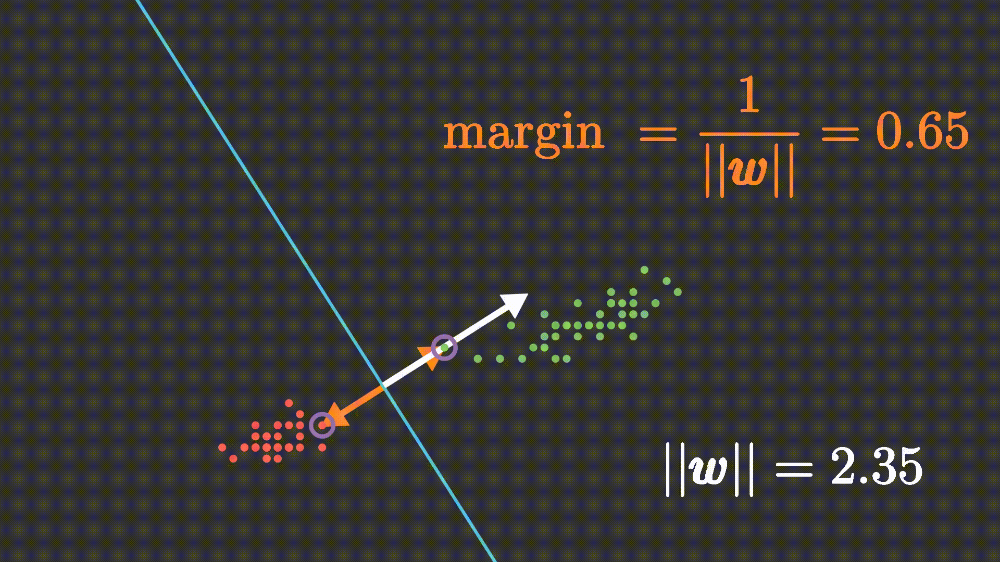

In [37]:
svc1 = SVC(C=0.002, kernel='poly')
svc1.fit(scaled_train, df_train['label']) # train

preds_train = svc1.predict(scaled_train) # get predictions for train data
preds_test = svc1.predict(scaled_test) # get predictions for test data

set_preds(df_train, df_test, preds_train, preds_test, f'svc') # save predictions for further use

cf = confusion_matrix(df_test['label'], preds_test)

print('Classification Report without Smote')
print(classification_report(df_test['label'], preds_test))

Classification Report without Smote
              precision    recall  f1-score   support

           0       0.94      1.00      0.97      2622
           1       0.70      0.08      0.14       186

    accuracy                           0.94      2808
   macro avg       0.82      0.54      0.55      2808
weighted avg       0.92      0.94      0.91      2808



In [38]:
svc1 = SVC(C=0.002, kernel='poly')
svc1.fit(X, y) # train

preds_train = svc1.predict(scaled_train) # get predictions for train data
preds_test = svc1.predict(scaled_test) # get predictions for test data

set_preds(df_train, df_test, preds_train, preds_test, f'svc') # save predictions for further use

cf = confusion_matrix(df_test['label'], preds_test)
                      
print('Classification Report with Smote')
print(classification_report(df_test['label'], preds_test))

Classification Report with Smote
              precision    recall  f1-score   support

           0       0.94      1.00      0.97      2622
           1       0.78      0.08      0.14       186

    accuracy                           0.94      2808
   macro avg       0.86      0.54      0.55      2808
weighted avg       0.93      0.94      0.91      2808



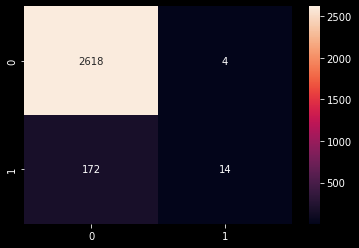

In [39]:
sns.heatmap(cf, annot=True, fmt='g')

## Result Analysis and UMAP clusters

### Distance as a means to analyze and evaluate performance

Setting up some helper functions for computing cosine and euclidean distances between embeddings.

In [40]:
def get_cosine_distances(df):
  # print(df.columns)
  x1 = np.array(df)
  ev = [distance.cosine(x1[i,:], x1[i+1, :]) for i in range(len(df)-1)]
  return ev

def get_euclidean_distances(df):
  # print(df.columns)
  x1 = np.array(df)
  ev = [distance.euclidean(x1[i,:], x1[i+1, :]) for i in range(len(df)-1)]
  return ev

Let's look at some plotted cosine distances between consecutive frame embeddings

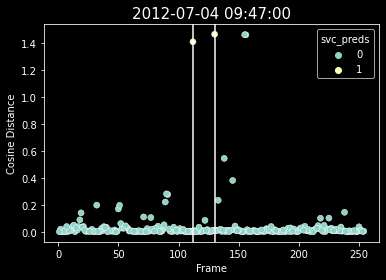

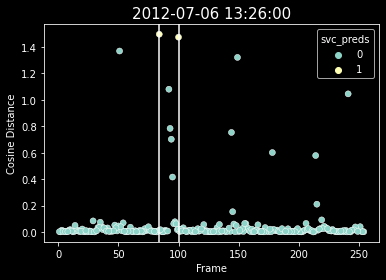

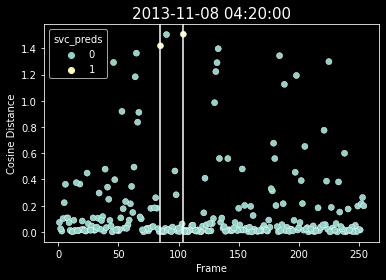

In [41]:
cnt = 0
maxcount = 9
mincount = 6
df = df_test.copy()
gr = df[emb_cols+['date','frame','svc_preds','label','Year']].sort_values(by='date', ascending=False).groupby('date')
for name in gr.groups:
    if cnt < mincount:
      cnt += 1
      continue

    group = gr.get_group(name).copy()
    cd = get_cosine_distances(group[emb_cols]) + [0]
    group['cos'] = cd

    fig = plt.figure() # mai mici figurile
    pos_f = group[group['label'] > 0]['frame'].tolist()
    pos_f.sort()
    sns.scatterplot(data=group, x="frame", y="cos", hue='svc_preds')#, palette=sns.husl_palette(2, h=.8))#, legend=True)


    plt.title(str(name), fontsize=15)
    plt.xlabel(f'Frame')
    plt.ylabel('Cosine Distance')   
    plt.gca().axvline(x=pos_f[0])
    plt.gca().axvline(x=pos_f[-1])

    plt.show()
    cnt +=1
    if cnt == maxcount:
        break

### UMAP as a means to reduce dimensionality and visualize clusters

UMAP is a fairly flexible non-linear dimension reduction algorithm. It seeks to learn the structure of your data and find a 2D embedding that preserves the essential topological structure of that data.

Apply dimensionality reduction via UMAP to reduce embedding vectors to Nx2 from Nx512

In [42]:
reducer=umap.UMAP(n_neighbors=15, min_dist=0.5)
scaler=StandardScaler()

scaled_train = scaler.fit_transform(df_train[emb_cols])
embedding_train = reducer.fit(scaled_train)

scaled_test = scaler.transform(df_test[emb_cols])
embedding_test = reducer.transform(scaled_test)

Save reduced UMAP embeddings to the embeddings dataframe

In [43]:
df_test['umap1'] = embedding_test[:,0]
df_test['umap2'] = embedding_test[:,1]

Helper function to introduce a new column called 'category' to help visualize results by prediction correctness

In [44]:
def update_color(df):
    df.loc[(df['label']==1) & (df['svc_preds']==1), 'category'] = 'TP' 
    df.loc[(df['label']==1) & (df['svc_preds']==0), 'category'] = 'FN' 
    df.loc[(df['label']==0) & (df['svc_preds']==1), 'category'] = 'FP' 
    df.loc[(df['label']==0) & (df['svc_preds']==0), 'category'] = 'TN' 
    return df

df_test = update_color(df_test)

Visualize clustering

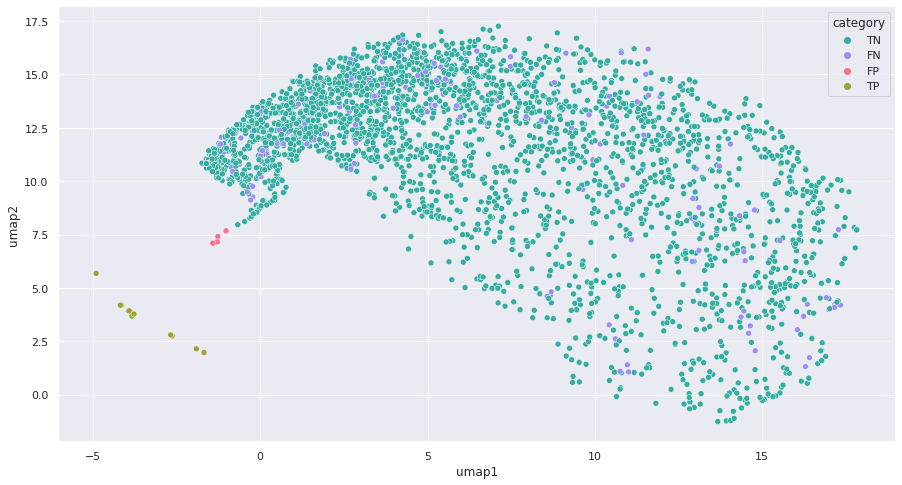

In [45]:
sns.set(rc = {'figure.figsize':(15,8)})

grs = df_test.groupby(['Year','month','day','Hour','Minute'])
groups = [grs.get_group(g) for g in grs.groups]

df1 = groups

plot = sns.scatterplot(data=df_test, x="umap1", y="umap2", hue='category', palette=sns.husl_palette(4, h=.5))

fig = plot.get_figure()

# Predicting Location: Object Detection

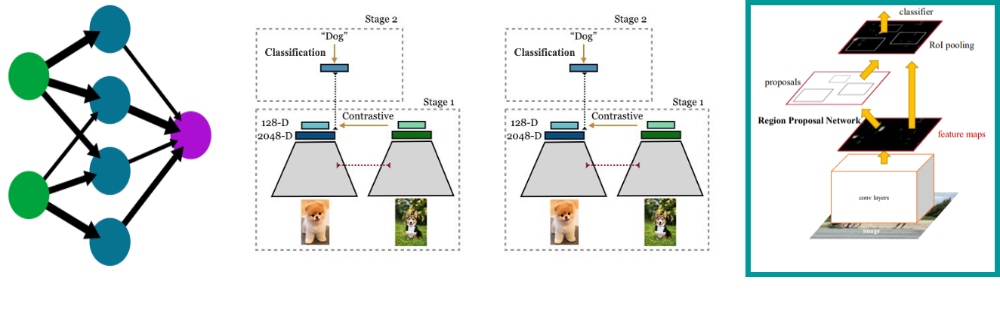

## Algorithm

The Object Detection approach relies on Faster R-CNN and consists of 3 main modules:


*   The first module generates region proposals using a Region Proposal Network that learns where to look for objects in the image.

*  After being resized to a fixed pre-defined size, the second module extracts a fixed-length feature vector from each region proposal.

*  The extracted feature vectors are then classified using a Softmax layer to predict the class scores and a second layer to predict the bounding boxes of the detected objects.


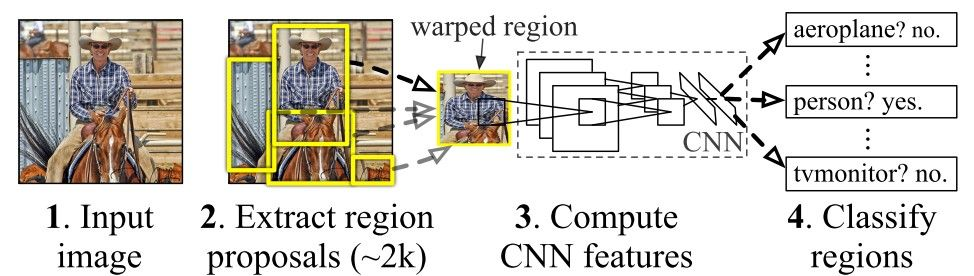

## Initialization

First, we load our pretrained Object Detection model from the torchvision library and set the number of classes the model should be able to predict.

In [46]:
os.chdir('../object-detection/')

In [47]:
def get_instance_segmentation_model(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with FastRCNN
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model

We initialize our model and load it onto the device.

In [48]:
model = get_instance_segmentation_model(num_classes=2)
model.to(device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

Then, we load parameters for our model from an already-trained checkpoint version.

In [49]:
state_dict = torch.load('object_detector.pt', map_location=torch.device(device))
model.load_state_dict(state_dict)

<All keys matched successfully>

We define a utility function to generate a plottable matplotlib rectangle based on given coordinates.

In [50]:
def get_rect(x0, y0, x1, y1, color=''):
    if x0 > x1:
      aux = x0
      x0 = x1
      x1 = aux
      
    if y0 > y1:
      aux = y0
      y0 = y1
      y1 = aux

    r = patches.Rectangle((x0, y0), x1-x0+3, y1-y0+3, linewidth=2, edgecolor=color, facecolor='none')
    return r

Now since we would like to only predict the location for those images for which the temporal occurence was predicted, we construct a list of their identifiers.

In [51]:
positive_temporal_predictions = df_test[(df_test['svc_preds']==1) & (df_test['label']==1)][['date','name','frame']].sort_values(by=['date','frame'], ascending=False)
positive_temporal_predictions

,date,name,frame
1509,2015-09-28 14:53:00,./c23_c24_val/poz/img_poz_2015_09_28_14_53_00_...,104
1130,2015-09-28 14:53:00,./c23_c24_val/poz/img_poz_2015_09_28_14_53_00_...,85
2350,2015-03-11 16:11:00,./c23_c24_val/poz/img_poz_2015_03_11_16_11_00_...,105
1251,2015-03-11 16:11:00,./c23_c24_val/poz/img_poz_2015_03_11_16_11_00_...,90
1948,2013-11-08 04:20:00,./c23_c24_val/poz/img_poz_2013_11_08_04_20_00_...,104
111,2013-11-08 04:20:00,./c23_c24_val/poz/img_poz_2013_11_08_04_20_00_...,85
1404,2012-07-06 13:26:00,./c23_c24_val/poz/img_poz_2012_07_06_13_26_00_...,100
859,2012-07-06 13:26:00,./c23_c24_val/poz/img_poz_2012_07_06_13_26_00_...,84
369,2012-07-04 09:47:00,./c23_c24_val/poz/img_poz_2012_07_04_09_47_00_...,130
1317,2012-07-04 09:47:00,./c23_c24_val/poz/img_poz_2012_07_04_09_47_00_...,112


In [52]:
os.mkdir("./out/")

## Data Loading

In [53]:
from dataset import SegDataset

In [54]:
import transforms as T

def get_transform(train):
    tr = []
    # converts the image, a PIL image, into a PyTorch Tensor
    tr.append(T.PILToTensor())
    if train:
        # during training, randomly flip the training images
        # and ground-truth for data augmentation
        tr.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(tr)

In [55]:
ds = SegDataset('./c24_pos_all/', 'test', get_transform(train=False), cycle='24')

## Model Inference

### Single Image Inference

./c24_pos_all/poz/img_poz_2015_01_03_09_40_00_96.jpg


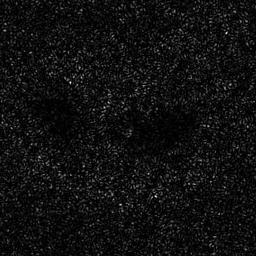

In [57]:
img, f = ds[6]
im = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
print(ds.imgs[f['image_id']])
im

./c24_pos_all/poz/img_poz_2015_01_03_09_40_00_96.jpg


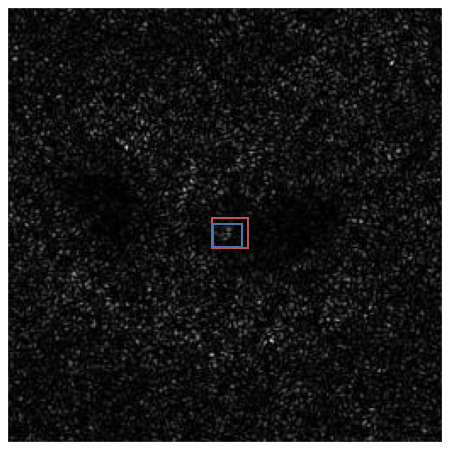

In [58]:
im = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
print(ds.imgs[f['image_id']])

fig, ax = plt.subplots()
ax.imshow(im)

model.eval() # set the model to evaluation mode
with torch.no_grad(): # disable gradient updates
    prediction = model([img.float().to(device)]) # apply the model to the floating point converted input image

real_box = f['boxes'][0].cpu().numpy() # retrieve real/ground truth sunquake signature box
r = get_rect(real_box[0], real_box[1], real_box[2], real_box[3], color='r') 

predicted_box = prediction[0]['boxes'][0].cpu().numpy() # retrieve preedicted sunquake signature box
r2 = get_rect(predicted_box[0], predicted_box[1], predicted_box[2], predicted_box[3], color='b') 

ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)

ax.add_patch(r)
ax.add_patch(r2)
plt.show()

Intersection over Union ca metrica de calcul a calitatii rezultatelor; sa pun si valoarea efectiva

### Full Data Inference

Postprocess constructed image paths to match the downloaded data.

In [59]:
positive_temporal_prediction_paths=positive_temporal_predictions['name'].str.split('_').map(lambda x : str.join('_',x[:-1]).split('/')[-1].replace('png','jpg')).unique()

In [60]:
positive_temporal_prediction_paths

array(['img_poz_2015_09_28_14_53_00', 'img_poz_2015_03_11_16_11_00',
       'img_poz_2013_11_08_04_20_00', 'img_poz_2012_07_06_13_26_00',
       'img_poz_2012_07_04_09_47_00', 'img_poz_2012_03_06_07_52_00',
       'img_poz_2012_03_05_19_27_00'], dtype=object)

Now let's apply our trained Object Detection model to our input image data which was positively predicted temporally, similar to how we infered the Contrastive Learning model.

In [ ]:
all=True # flag to determine whether all predicted boxes should be plotted or only the one with the highest probability
model.eval() #

for i in range(0,len(ds)): # iterate through the dataset
  img, f = ds[i]
  # put the model in evaluation mode
  with torch.no_grad(): # disable gradients
    prediction = model([img.float().to(device)]) # apply the model to the floating point converted input

    name = ds.imgs[f['image_id']] # extract the name of the image from the dataset

    is_test_data = sum([True if path in name else False for path in positive_temporal_prediction_paths]) > 0 # flag to skip images that were not predicted positve by the temporal predictors
    if (not is_test_data):
      continue
      
    print(name)

    im = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())

    fig, ax = plt.subplots(figsize=(8,8))
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # ax.imshow(im)
    box = f['boxes'][0].cpu().numpy() # retrieve real/ground truth sunquake signature box
    r = get_rect(box[0], box[1], box[2], box[3],'g')
    ax.add_patch(r)

    if all: 
      for k in range(len(prediction[0]['boxes'])): # go through all box preedictions
        if prediction[0]['scores'][k] > 0.15: # that have a higher probability than 0.15
          box = prediction[0]['boxes'][k].cpu().numpy()  # retrieve predicted sunquake signature box
          r = get_rect(box[0], box[1], box[2], box[3], color='b' if k > 0 else 'r')
          ax.add_patch(r) # plot box
    else:
      box = prediction[0]['boxes'][0].cpu().numpy() # retrieve the predicted box with highest probability
      r = get_rect(box[0], box[1], box[2], box[3], color='b' if k > 0 else 'r')
      ax.add_patch(r) # plot box

    plt.savefig(f"./out/detected_regions_{ds.imgs[f['image_id']].split('/')[-1]}", transparent=True) 
    plt.close(fig) 